# Switch CREG12.L75 to both Xarray & Dask for the analyse

In [1]:
import dask_hpcconfig
from distributed import Client
dask_hpcconfig.print_clusters()
clusters = dask_hpcconfig.available_clusters()
clusters

Available clusters:
 • local: local
 • datarmor-local: local
 • datarmor: pbs
 • datarmor-seq: pbs


{'local': 'local',
 'datarmor-local': 'local',
 'datarmor': 'pbs',
 'datarmor-seq': 'pbs'}

In [2]:
memory_size = 25
n_worker_per_node = 115 // memory_size
n_threads_per_worker = 28 // n_worker_per_node
print(n_worker_per_node, n_threads_per_worker)

4 7


In [3]:
overrides = {
#    "cluster.threads_per_worker": n_threads_per_worker,
#    "cluster.n_workers": n_worker_per_node,
}

In [4]:
overrides

{}

In [5]:
cluster = dask_hpcconfig.cluster("datarmor", **overrides)
#cluster = dask_hpcconfig.cluster("datarmor-local", **overrides)  
client = Client(cluster)
client

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


Connection method: Cluster object,Cluster type: dask_jobqueue.PBSCluster
Dashboard: http://10.148.0.72:8787/status,
Dashboard: http://10.148.0.72:8787/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://10.148.0.72:48020,Workers: 0
Dashboard: http://10.148.0.72:8787/status,Total threads: 0
Started: Just now,Total memory: 0 B


In [6]:
cluster.scale(jobs=3)

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


In [7]:
import xarray as xr 
import matplotlib.pylab as plt
import numpy as np
import hvplot.xarray
import cartopy.crs as crs

In [8]:
! date 

Thu Dec 19 14:41:53 GMT 2024


# FUNCTIONS

In [9]:
from mpl_toolkits.basemap import Basemap
import matplotlib as mpl

def Arc_plot(zlon,zlat,ztab,zcontours,zlim,zmap='Spectral_r',proj='cassi',fld='',log10=False): 

    if proj == 'npstere' :
        m = Basemap(projection='npstere',boundinglat=75,lon_0=-140, resolution='l')
    elif proj == 'npstereNA' :
        m = Basemap(projection='npstere',boundinglat=65,lon_0=-20, resolution='l')
    elif proj == 'cassi' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)  
    elif proj == 'gin' :
        m = Basemap(llcrnrlon=-20,llcrnrlat=60,urcrnrlon=60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=0,lat_0=65)    
    elif proj == 'cassis_BGZoom' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-110,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)    
    elif proj == 'cassis_BGZoom_HR' :
        m = Basemap(llcrnrlon=-80,llcrnrlat=80,urcrnrlon=-180,urcrnrlat=60, resolution='i',\
                    projection='cass',lon_0=0,lat_0=80)    
        
    zfontsize=12
    m.drawparallels(np.arange(-90.,91.,5.),labels=[False,False,False,False], size=zfontsize, linewidth=0.3, alpha=0.5)
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[True,False,False,True], size=zfontsize, latmax=90.,linewidth=0.3,alpha=0.7)
    m.fillcontinents(color='grey')

    if log10:
        znorm = mpl.colors.LogNorm(vmin=limits[0], vmax=limits[1])
    else:
        znorm = mpl.colors.Normalize(vmin=limits[0], vmax=limits[1])

    X,Y = m(zlon,zlat)
    m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
    #m.contourf(X,Y,ztab,zcontours,cmap=zmap,extend='both')


    plt.colorbar(extend='both',shrink=0.9) # For the 2 figures over 1 line
    #plt.colorbar(extend='both',shrink=0.3) # For the 3 figures over 1 line
    #cbar.set_label(fld, fontsize=12, rotation=270)
    #cbar.ax.tick_params(labelsize=10)
    
    #zcontours=np.arange(0.,1000.,100)
    #C=m.contour(X,Y,ztab,levels=zcontours,colors='black',alpha=0.8)
    #plt.clabel(C,C.levels,inline=True,fmt='%.0f',fontsize=15)


In [10]:
def GeoBox(lfig,area='large'):
    props = dict(boxstyle='round', facecolor='y', alpha=1.0)

    if area == 'large' :     
        lfig.text(0.26, 0.17, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.41, 0.87, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)

        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.17, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)
        
    elif area == 'zoom' :
        lfig.text(0.28, 0.24, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.51, 0.8, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)
        
        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.24, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)

# CREG12.L75 grid 

In [11]:
DDIR="/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID"
ds_sedna_bat=xr.open_dataset(DDIR+'/'+'bathymetry_CREG12_V3.3_CT20180612Larger_ct20190102.nc')

In [12]:
%%time 
CDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'
ds_coord=xr.open_dataset(CDIR+'coordinates_CREG12.L75.nc',chunks={'t':1 ,'z':15,'y':500, 'x':500})

CPU times: user 192 ms, sys: 60 ms, total: 252 ms
Wall time: 2.2 s


In [13]:
ds_coord

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580)
Dimensions without coordinates: y, x
Data variables: (12/18)
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamt    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamv    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamf    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    ...       ...
    e1v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e1f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2t      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2u      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>

In [14]:
ds_coord=ds_coord.set_coords('nav_lon')
ds_coord=ds_coord.set_coords('nav_lat')
#ds_coord=ds_coord.set_coords('nav_lev')
#ds_coord=ds_coord.set_coords('time_counter')

In [15]:
ds_coord

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580)
Coordinates:
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: y, x
Data variables: (12/16)
    glamt    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamv    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamf    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    gphit    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    gphiu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    ...       ...
    e1v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e1f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2t      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2u      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>

In [16]:
mfile='CREG12.L75-REF06_mesh_mask.nc'
MDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'

In [17]:
ds_mesh=xr.open_dataset(MDIR+mfile,chunks={'time_counter':1 ,'z':15,'y':500, 'x':500})

In [18]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Dimensions without coordinates: t, z, y, x
Data variables: (12/24)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphit     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [19]:
ds_mesh.nbytes*1e-9

6.04116694

In [20]:
ds_mesh=ds_mesh.set_coords('gphit')
ds_mesh=ds_mesh.set_coords('glamt')

In [21]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Coordinates:
    glamt     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphit     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Dimensions without coordinates: t, z, y, x
Data variables: (12/22)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [22]:
ds_mesh=ds_mesh.rename_vars({'gphit':'nav_lat'})
ds_mesh=ds_mesh.rename_vars({'glamt':'nav_lon'})

In [23]:
ds_mesh=ds_mesh.rename_dims({'z':'nav_lev'})

In [24]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, nav_lev: 75, y: 1801, x: 1580)
Coordinates:
    nav_lon   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Dimensions without coordinates: t, nav_lev, y, x
Data variables: (12/22)
    e3t_0     (t, nav_lev, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, nav_lev, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, nav_lev, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, nav_lev) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, nav_lev, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [25]:
# Get only the tmask array
tmask=ds_mesh['tmask'].isel(t=0)
tmask

<xarray.DataArray 'tmask' (nav_lev: 75, y: 1801, x: 1580)>
dask.array<getitem, shape=(75, 1801, 1580), dtype=int8, chunksize=(15, 500, 500), chunktype=numpy.ndarray>
Coordinates:
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: nav_lev, y, x

# Read monthly mean TKE/EKE  

In [26]:
import glob

In [107]:
cyear=2010
ftype='TEKE'

In [108]:
DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'

In [109]:
lref=sorted(glob.glob(DATAIN+str(cyear)+'/1m/'+'CREG12.L75-REF08_y'+str(cyear)+'m*.1m_'+ftype+'.nc'))
lref

['/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m01.1m_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m02.1m_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m03.1m_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m04.1m_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m05.1m_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010m06.1m_TEKE.nc',
 '/home/datawork-lops-

In [110]:
%%time 
ds_year=xr.open_mfdataset(lref, chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500}, engine="netcdf4")
#chunks={'time_counter':1 ,'deptht':1,'y':1300, 'x':1300}, engine="netcdf4")
#,combine='by_coords',concat_dim=["time_counter"],parallel=True)
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 20.761352076 GB
CPU times: user 444 ms, sys: 108 ms, total: 552 ms
Wall time: 1.55 s


In [111]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 12, y: 1801, x: 1580, deptht: 75)
Coordinates:
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2010-01-16 00:00:00 ... 2010-12-14 12...
Dimensions without coordinates: y, x
Data variables:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    voeke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [112]:
ds_year=ds_year.set_coords('nav_lon')
ds_year=ds_year.set_coords('nav_lat')

In [113]:
ds_year=ds_year.rename_dims({'deptht':'nav_lev'})

In [114]:
ds_year=ds_year.rename_vars({'deptht':'nav_lev'})

In [115]:
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 20.761352076 GB


In [116]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 12, y: 1801, x: 1580, nav_lev: 75)
Coordinates:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * nav_lev       (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2010-01-16 00:00:00 ... 2010-12-14 12...
Dimensions without coordinates: y, x
Data variables:
    voeke         (time_counter, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

# Group by season [JFM - AMJ - JAS - OND] 

In [117]:
def my_seasons(lmonths):
    # Function to redefine the seasons I wanted
    seasons = xr.full_like(lmonths, fill_value="none", dtype="U3")
    seasons.name = "season"
    seasons[months.isin([1, 2, 3])] = "JFM"
    seasons[months.isin([4, 5, 6])] = "AMJ"
    seasons[months.isin([7, 8, 9])] = "JAS"
    seasons[months.isin([10, 11, 12])] = "OND"
    return seasons

In [118]:
months=ds_year.time_counter.dt.month
seasons=my_seasons(months) 
print('Months: \n', months, ' \n Seasons: \n', seasons)

Months: 
 <xarray.DataArray 'month' (time_counter: 12)>
array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])
Coordinates:
  * time_counter  (time_counter) object 2010-01-16 00:00:00 ... 2010-12-14 12...
Attributes:
    axis:           T
    standard_name:  time
    long_name:      Time axis
    time_origin:    1900-01-01 00:00:00
    bounds:         time_counter_bounds  
 Seasons: 
 <xarray.DataArray 'season' (time_counter: 12)>
array(['JFM', 'JFM', 'JFM', 'AMJ', 'AMJ', 'AMJ', 'JAS', 'JAS', 'JAS',
       'OND', 'OND', 'OND'], dtype='<U3')
Coordinates:
  * time_counter  (time_counter) object 2010-01-16 00:00:00 ... 2010-12-14 12...
Attributes:
    axis:           T
    standard_name:  time
    long_name:      Time axis
    time_origin:    1900-01-01 00:00:00
    bounds:         time_counter_bounds


In [119]:
# Now we can groupby seasons
ds_seas = ds_year.groupby(seasons).mean().reindex(season =['JFM','AMJ','JAS','OND'])
ds_seas

<xarray.Dataset>
Dimensions:  (nav_lev: 75, season: 4, y: 1801, x: 1580)
Coordinates:
  * nav_lev  (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * season   (season) <U3 'JFM' 'AMJ' 'JAS' 'OND'
Dimensions without coordinates: y, x
Data variables:
    voeke    (season, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke    (season, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [120]:
ds_seas.coords['nav_lon']=ds_year.coords['nav_lon'].isel(time_counter=0)
ds_seas.coords['nav_lat']=ds_year.coords['nav_lat'].isel(time_counter=0)
print('           Size othe yearly EKE dataset :', ds_seas.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 6.852156996000001 GB


In [121]:
ds_seas

<xarray.Dataset>
Dimensions:       (nav_lev: 75, season: 4, y: 1801, x: 1580)
Coordinates:
  * nav_lev       (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * season        (season) <U3 'JFM' 'AMJ' 'JAS' 'OND'
    nav_lat       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    time_counter  object 2010-01-16 00:00:00
    nav_lon       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: y, x
Data variables:
    voeke         (season, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (season, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [122]:
%%time 
# Create a new Dataset for the mean energy  
if True: 
    ds_yearout=xr.Dataset()
    ds_yearout.coords['nav_lat']=(ds_seas.coords['nav_lat'])
    ds_yearout.coords['nav_lon']=(ds_seas.coords['nav_lon'])
    ds_yearout.coords['nav_lev']=(ds_seas.coords['nav_lev'])
    ds_yearout.coords['season']=(ds_seas.coords['season'])
    ds_yearout['voeke']=(('season','nav_lev','y','x'),xr.where(np.array(tmask) == 0.,np.nan,np.array(ds_seas['voeke'])))
    ds_yearout['voeke'].attrs['long_name']='Seasonal mean EKE '
    ds_yearout['voeke'].attrs['units']='m2s-2'
    
    ds_yearout['votke']=(('season','nav_lev','y','x'),xr.where(np.array(tmask) == 0.,np.nan,np.array(ds_seas['votke'])))
    ds_yearout['votke'].attrs['long_name']='Seasonal mean TKE '
    ds_yearout['votke'].attrs['units']='m2s-2'
    
    OUTDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'
    if True: ds_yearout.to_netcdf(OUTDIR+str(cyear)+'/1m/'+'CREG12.L75-REF08_y'+str(cyear)+'.seas_TEKE.nc')

CPU times: user 22.6 s, sys: 19.3 s, total: 41.9 s
Wall time: 44.9 s


# Now compute the seasonal climatology over 2011-2015

In [124]:
import glob
DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'
lref=[]
ftype='TEKE'
#for zyear in np.arange(5)+2011:
for zyear in np.arange(7)+2008:
    lref.append(sorted(glob.glob(DATAIN+str(zyear)+'/1m/'+'CREG12.L75-REF08_y'+str(zyear)+'.seas_'+ftype+'.nc'))[0])
lref

['/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2008/1m/CREG12.L75-REF08_y2008.seas_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2009/1m/CREG12.L75-REF08_y2009.seas_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2010/1m/CREG12.L75-REF08_y2010.seas_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2011/1m/CREG12.L75-REF08_y2011.seas_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2012/1m/CREG12.L75-REF08_y2012.seas_TEKE.nc',
 '/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/2013/1m/CREG12.L75-REF08_y2013.seas_TEKE.nc',
 '/home/datawork-lops-drakka

In [125]:
%%time 
ds_clim=xr.open_mfdataset(lref, chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500}, engine="netcdf4",combine='nested',concat_dim=["season"])
#chunks={'time_counter':1 ,'deptht':1,'y':1300, 'x':1300}, engine="netcdf4")
#,combine='by_coords',concat_dim=["time_counter"],parallel=True)
print('           Size othe yearly TKE/EKE dataset :', ds_clim.nbytes*1e-9,'GB')

           Size othe yearly TKE/EKE dataset : 47.828509388 GB
CPU times: user 1.88 s, sys: 252 ms, total: 2.13 s
Wall time: 4.65 s


In [126]:
ds_clim

<xarray.Dataset>
Dimensions:       (season: 28, y: 1801, x: 1580, nav_lev: 75)
Coordinates:
    time_counter  (season) object 2008-01-16 00:00:00 ... 2014-01-16 00:00:00
    nav_lon       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
  * nav_lev       (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * season        (season) object 'JFM' 'AMJ' 'JAS' 'OND' ... 'AMJ' 'JAS' 'OND'
Dimensions without coordinates: y, x
Data variables:
    voeke         (season, nav_lev, y, x) float32 dask.array<chunksize=(4, 75, 500, 500), meta=np.ndarray>
    votke         (season, nav_lev, y, x) float32 dask.array<chunksize=(4, 75, 500, 500), meta=np.ndarray>

In [127]:
seasonal_climatology = ds_clim.groupby('season').mean().reindex(season =['JFM','AMJ','JAS','OND'])

In [129]:
OUTDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'
if True: seasonal_climatology.to_netcdf(OUTDIR+'2008-2014/CREG12.L75-REF08_y2008-2014.seas_TEKE.nc')

# Plot EKE & TKE maps @ surface, 147m & 411m

 FIELD plot:  EKE
 >>>>>>>>>>>  Depth plot:  0.0


/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 >>>>>>>>>>>  Depth plot:  200.0


/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.1650444.datarmor0/ipykernel_55573/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

CPU times: user 1min 34s, sys: 8.06 s, total: 1min 42s
Wall time: 5min 10s


<Figure size 640x480 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

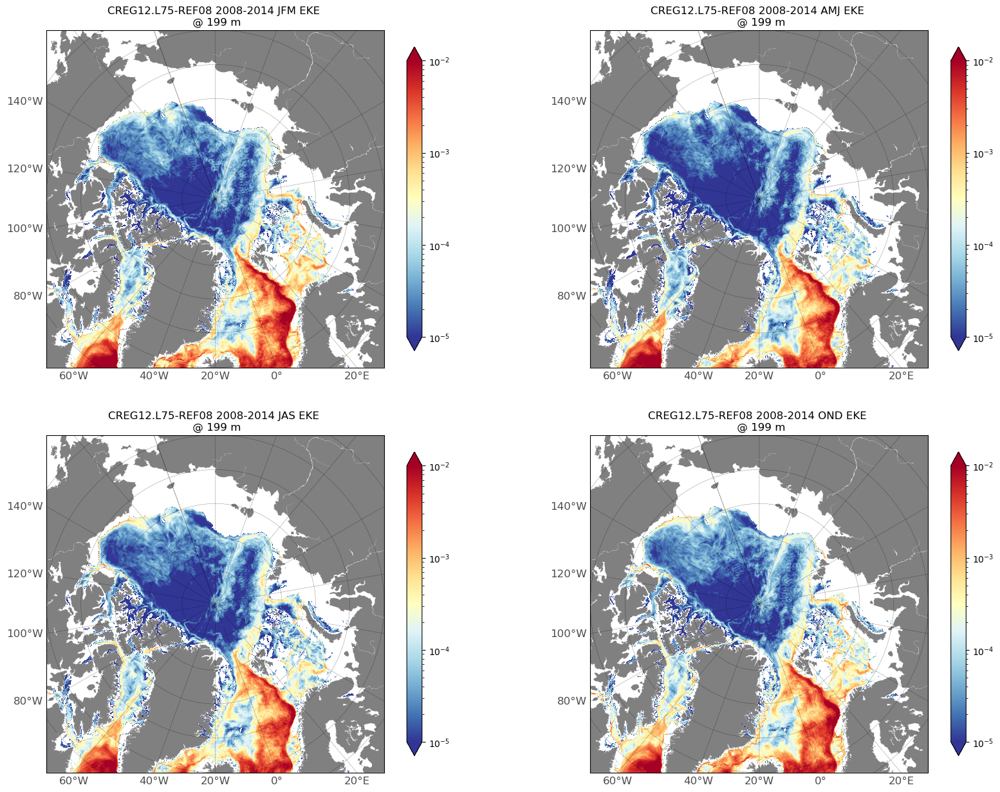

In [131]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

# List of depth for plotting maps
#lst_depths=[0.,150.,400.]
lst_depths=[0.,200.]
periodtitle='2008-2014'

# Loop over field 
#for ene in ['TKE','EKE']:
for ene in ['EKE']:
    
    lvar='votke'
    if ene == 'EKE' : lvar='voeke'
    print(' FIELD plot: ',ene)
    
    # Loop over depths:
    for ld in lst_depths: 
        zdepth=str(int(seasonal_climatology.nav_lev.sel(nav_lev=ld, method='nearest').data))
        print(' >>>>>>>>>>>  Depth plot: ', ld)

        plt.clf()
        plt.figure(figsize=(20,15))
        plt.subplot(221)
        Arc_plot(np.array(seasonal_climatology['nav_lon']),np.array(seasonal_climatology['nav_lat']), \
                 seasonal_climatology[lvar].sel(nav_lev=ld,method='nearest').sel(season='JFM'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 '+periodtitle+' JFM '+ene+' \n @ '+zdepth+' m')

        plt.subplot(222)
        Arc_plot(np.array(seasonal_climatology['nav_lon']),np.array(seasonal_climatology['nav_lat']), \
                 seasonal_climatology[lvar].sel(nav_lev=ld,method='nearest').sel(season='AMJ'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 '+periodtitle+' AMJ '+ene+' \n @ '+zdepth+' m')

        plt.subplot(223)
        Arc_plot(np.array(seasonal_climatology['nav_lon']),np.array(seasonal_climatology['nav_lat']), \
                 seasonal_climatology[lvar].sel(nav_lev=ld,method='nearest').sel(season='JAS'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 '+periodtitle+' JAS '+ene+' \n @ '+zdepth+' m')

        plt.subplot(224)
        Arc_plot(np.array(seasonal_climatology['nav_lon']),np.array(seasonal_climatology['nav_lat']), \
                 seasonal_climatology[lvar].sel(nav_lev=ld,method='nearest').sel(season='OND'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 '+periodtitle+' OND '+ene+' \n @ '+zdepth+' m')

        #GeoBox(fig)

        if True : plt.savefig('./FIGURES/CREG12.L75-REF08_'+periodtitle+'.Seas_'+ene+'_z'+zdepth+'m.png',dpi=300)

# Control that we recover the clim mean over the full period 2011-2015

In [32]:
OUTDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'
if True: seasonal_climatology=xr.open_dataset(OUTDIR+'2011-2015/CREG12.L75-REF08_y2011-2015.seas_TEKE.nc',chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500})

In [33]:
seasonal_climatology

<xarray.Dataset>
Dimensions:  (nav_lev: 75, season: 4, y: 1801, x: 1580)
Coordinates:
  * nav_lev  (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * season   (season) object 'JFM' 'AMJ' 'JAS' 'OND'
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: y, x
Data variables:
    voeke    (season, nav_lev, y, x) float32 dask.array<chunksize=(4, 75, 500, 500), meta=np.ndarray>
    votke    (season, nav_lev, y, x) float32 dask.array<chunksize=(4, 75, 500, 500), meta=np.ndarray>

In [34]:
mean_climatology = seasonal_climatology.mean('season').compute()

 FIELD plot:  TKE
 >>>>>>>>>>>  Depth plot:  0.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 >>>>>>>>>>>  Depth plot:  150.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 >>>>>>>>>>>  Depth plot:  400.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 FIELD plot:  EKE
 >>>>>>>>>>>  Depth plot:  0.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 >>>>>>>>>>>  Depth plot:  150.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

 >>>>>>>>>>>  Depth plot:  400.0


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

CPU times: user 1min 40s, sys: 11.4 s, total: 1min 52s
Wall time: 1min 38s


<Figure size 640x480 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

<Figure size 2000x1500 with 0 Axes>

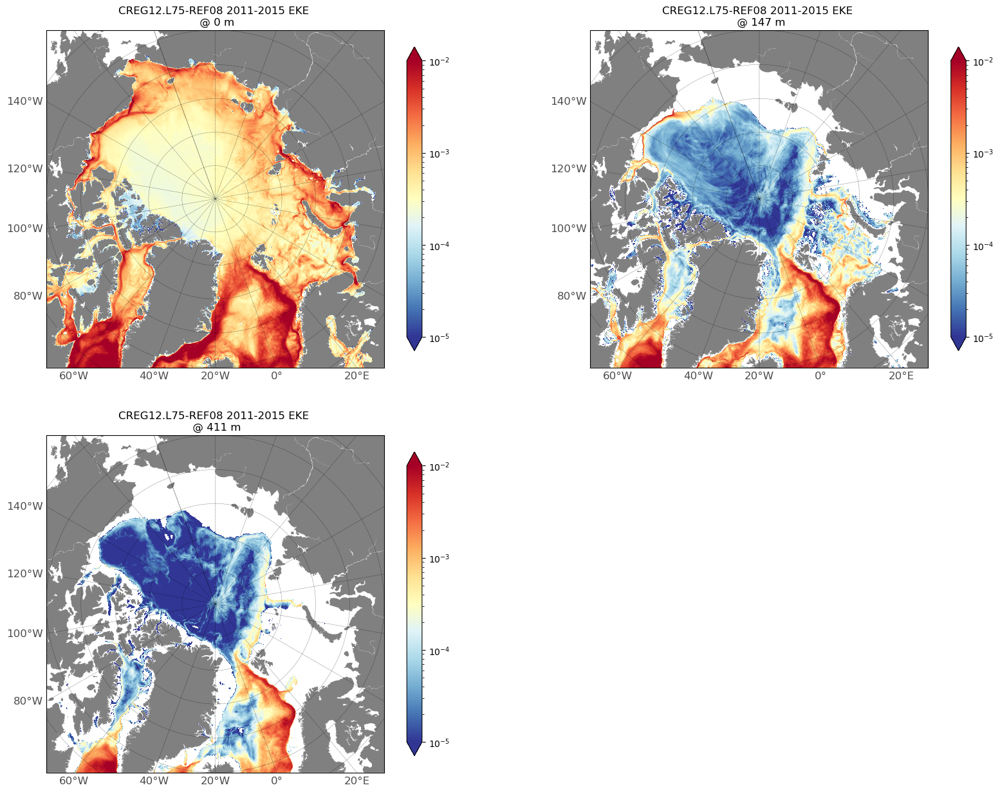

In [37]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

# List of depth for plotting maps
lst_depths=[0.,150.,400.]

# Loop over field 
for ene in ['TKE','EKE']:
    
    lvar='votke'
    if ene == 'EKE' : lvar='voeke'
    print(' FIELD plot: ',ene)
    
    # Loop over depths:
    for ld in lst_depths: 
        zdepth=str(int(mean_climatology.nav_lev.sel(nav_lev=ld, method='nearest').data))
        print(' >>>>>>>>>>>  Depth plot: ', ld)

        plt.clf()
        plt.figure(figsize=(20,15))
        plt.subplot(221)
        Arc_plot(np.array(mean_climatology['nav_lon']),np.array(mean_climatology['nav_lat']), \
                 mean_climatology[lvar].sel(nav_lev=0.,method='nearest'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ 0 m')

        plt.subplot(222)
        Arc_plot(np.array(mean_climatology['nav_lon']),np.array(mean_climatology['nav_lat']), \
                 mean_climatology[lvar].sel(nav_lev=150.,method='nearest'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ 147 m')

        plt.subplot(223)
        Arc_plot(np.array(mean_climatology['nav_lon']),np.array(mean_climatology['nav_lat']), \
                 mean_climatology[lvar].sel(nav_lev=400.,method='nearest'), \
                 contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
        plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ 411 m')

        if True : plt.savefig('./FIGURES/CREG12.L75-REF08_Clim_2011-2015.1y_'+ene+'_z0-150-400m.png',dpi=300)

# Compute a climatology for the MKE

In [26]:
if True:
    # Read original NetcDF files
    import glob
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/ENERGETICS/'
    lvar_ene='MKE'  ; zvar='vomke'
    lref=sorted(glob.glob(DATAIN+'/*/1y/CREG12.L75-REF08_y*.1y_'+lvar_ene+'.nc'))

    ds_year=xr.open_mfdataset(lref,chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500},combine='nested',concat_dim=['time_counter'],engine="netcdf4")
    ds_year=ds_year.rename_dims({'deptht':'nav_lev'})
    ds_year=ds_year.rename_vars({'deptht':'nav_lev'})

In [27]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 5, y: 1801, x: 1580, nav_lev: 75)
Coordinates:
  * nav_lev       (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2011-07-02 11:58:56 ... 2015-06-30 11...
Dimensions without coordinates: y, x
Data variables:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    vomke         (time_counter, nav_lev, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [28]:
ds_climatlogy = ds_year.mean('time_counter').compute()
ds_climatlogy

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580, nav_lev: 75)
Coordinates:
  * nav_lev  (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    nav_lon  (y, x) float32 -93.67 -93.58 -93.5 -93.42 ... 102.1 102.0 102.0
    nav_lat  (y, x) float32 25.58 25.58 25.58 25.58 ... 55.12 55.1 55.08 55.05
    vomke    (nav_lev, y, x) float32 nan nan nan nan nan ... inf inf inf inf inf

 FIELD plot:  MKE


/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8737425.datarmor0/ipykernel_53321/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

CPU times: user 16.6 s, sys: 1.81 s, total: 18.4 s
Wall time: 16.1 s


<Figure size 640x480 with 0 Axes>

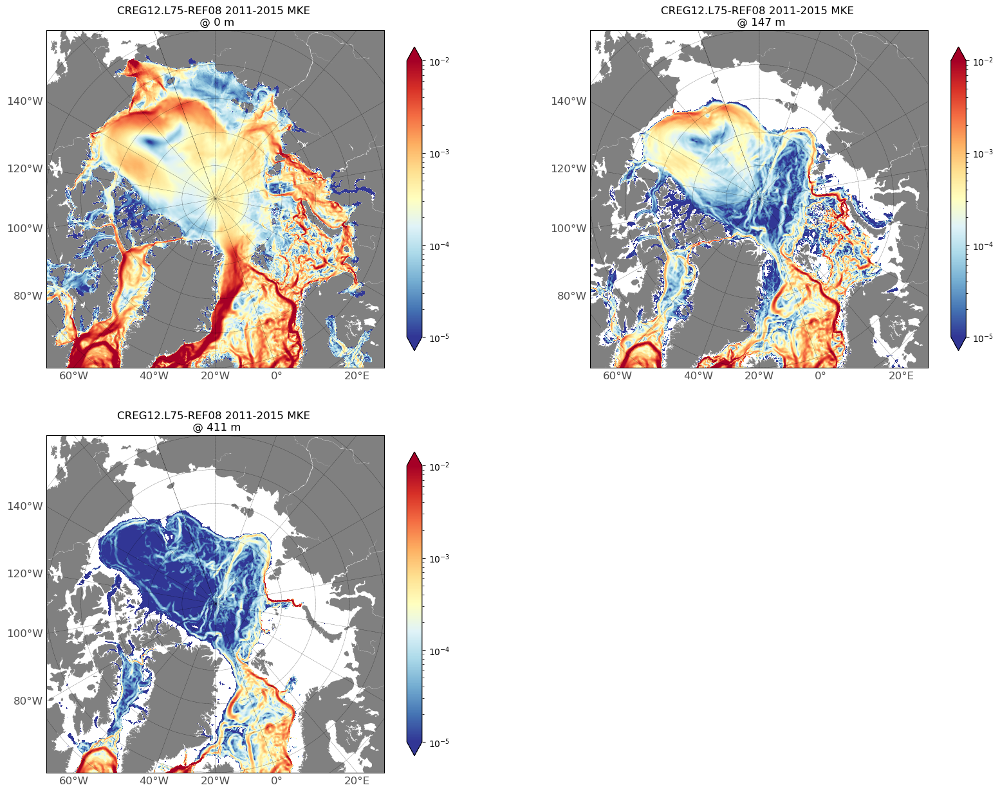

In [30]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

for ene in ['MKE']:

    lvar='vomke'
    print(' FIELD plot: ',ene)

    plt.clf()
    plt.figure(figsize=(20,15))
    plt.subplot(221)
    zdepth=str(int(ds_climatlogy.nav_lev.sel(nav_lev=0, method='nearest').data))
    Arc_plot(np.array(ds_climatlogy['nav_lon']),np.array(ds_climatlogy['nav_lat']), \
            ds_climatlogy[lvar].sel(nav_lev=0., method='nearest'), \
            contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)#,zbat=ds_sedna_bat)
    plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ '+zdepth+' m')

    plt.subplot(222)
    zdepth=str(int(ds_climatlogy.nav_lev.sel(nav_lev=150., method='nearest').data))
    Arc_plot(np.array(ds_climatlogy['nav_lon']),np.array(ds_climatlogy['nav_lat']), \
            ds_climatlogy[lvar].sel(nav_lev=150., method='nearest'), \
            contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)#,zbat=ds_sedna_bat)
    plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ '+zdepth+' m')

    plt.subplot(223)
    zdepth=str(int(ds_climatlogy.nav_lev.sel(nav_lev=400., method='nearest').data))
    Arc_plot(np.array(ds_climatlogy['nav_lon']),np.array(ds_climatlogy['nav_lat']), \
            ds_climatlogy[lvar].sel(nav_lev=400., method='nearest'), \
            contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)#,zbat=ds_sedna_bat)
    plt.title('CREG12.L75-REF08 2011-2015 '+ene+' \n @ '+zdepth+' m')

    #GeoBox(fig)

    if True : plt.savefig('./FIGURES/CREG12.L75-REF08_Clim_2011-2015.1y_'+ene+'_z0-150-400m.png',dpi=300)

In [56]:
client.close()
cluster.close()

# Plot the ratio EKE/KE & MKE/EKE @ surface, 81m & 147m & 411m 

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 11 s, sys: 1.47 s, total: 12.5 s
Wall time: 18.5 s


<Figure size 640x480 with 0 Axes>

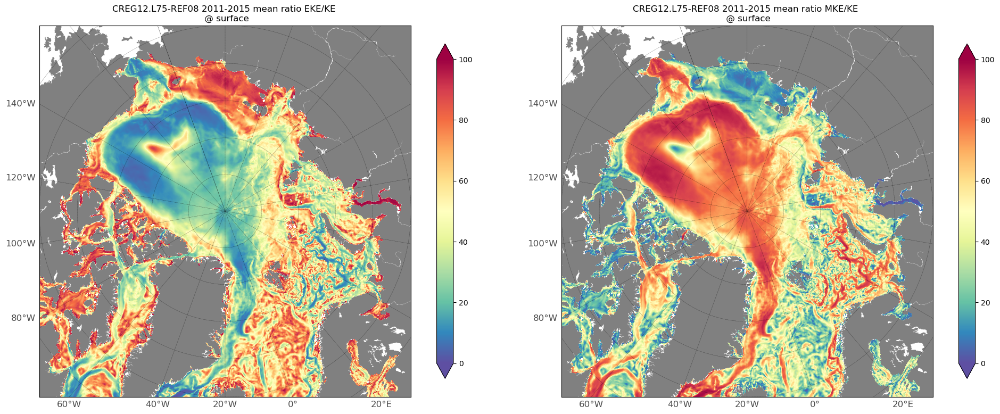

In [41]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=0), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ surface')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=0), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ surface')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z0m_y20112015.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 10.8 s, sys: 1.5 s, total: 12.3 s
Wall time: 16.3 s


<Figure size 640x480 with 0 Axes>

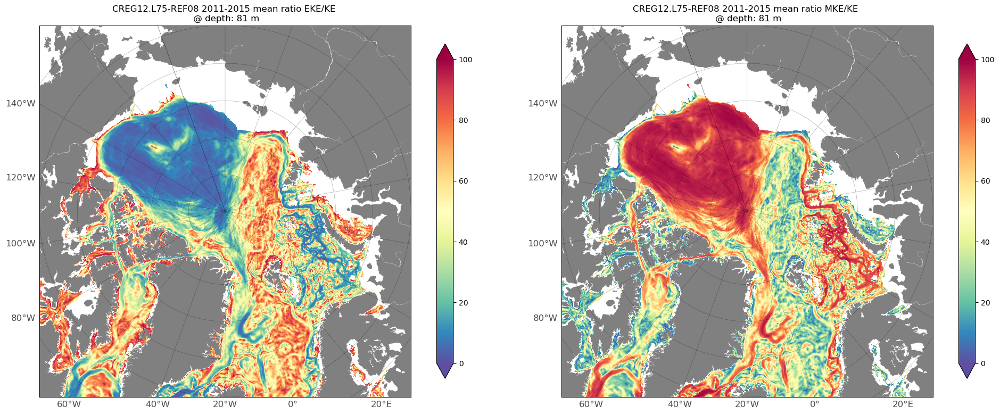

In [42]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=21), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 81 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=21), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 81 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z81m_y20112015.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 11 s, sys: 1.43 s, total: 12.4 s
Wall time: 16 s


<Figure size 640x480 with 0 Axes>

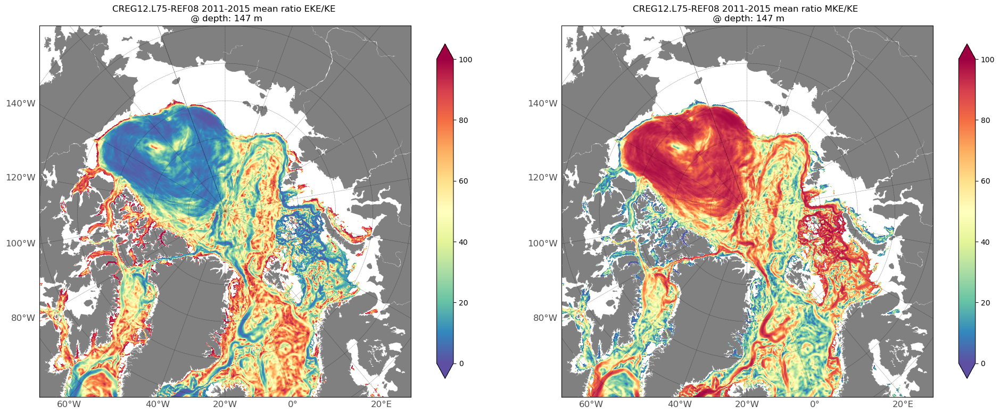

In [43]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=27), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 147 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=27), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 147 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z147m_y20112015.png',dpi=300)

/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 10.8 s, sys: 1.43 s, total: 12.2 s
Wall time: 20.7 s


<Figure size 640x480 with 0 Axes>

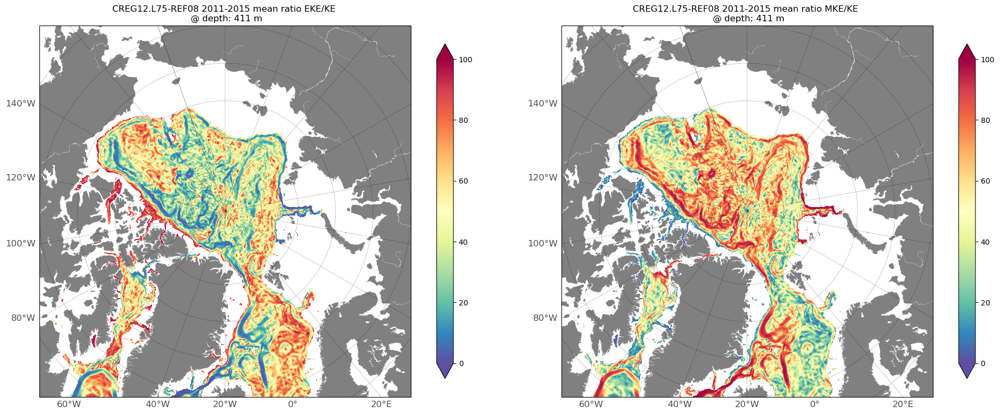

In [42]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=37), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 411 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=37), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 411 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z411m_y20112015.png',dpi=300)

In [39]:
print(int(ds_meanyear['deptht'].sel(deptht=400, method='nearest').values))
print(int(ds_meanyear['deptht'].isel(deptht=37).values))

411
411


# Plot the vertical integration over 200m for KE, EKE & MKE   

CPU times: user 300 ms, sys: 44 ms, total: 344 ms
Wall time: 342 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean KE \n vertically integrated over 200m')

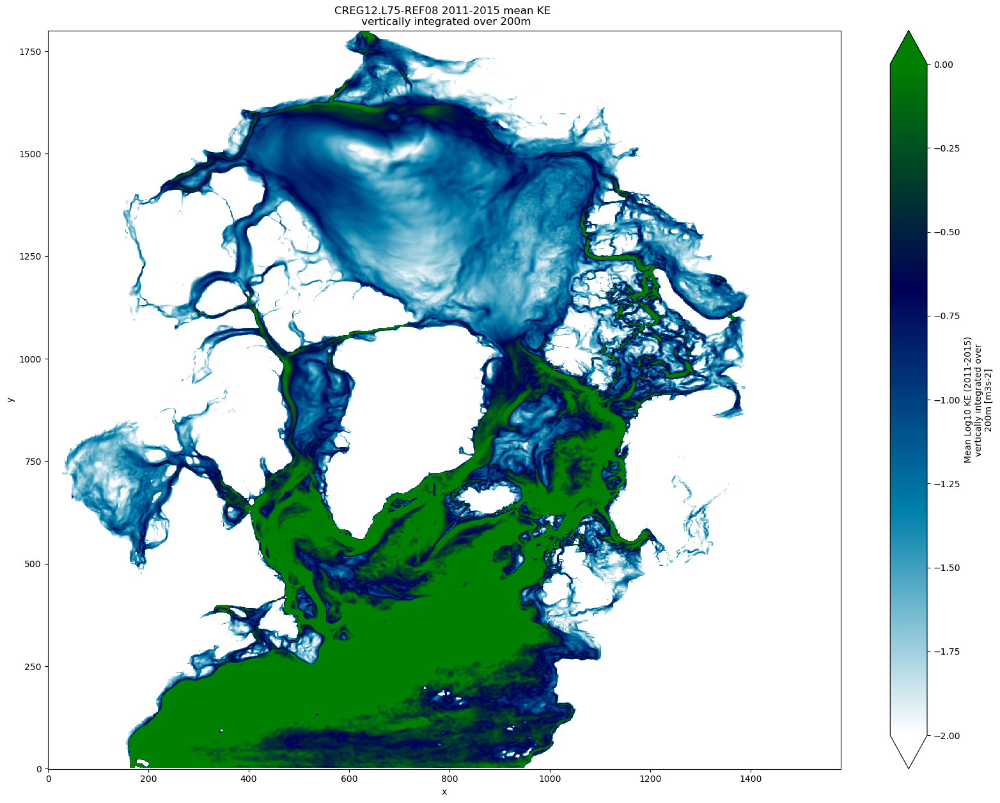

In [48]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvotke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 mean KE \n vertically integrated over 200m')

CPU times: user 304 ms, sys: 24 ms, total: 328 ms
Wall time: 326 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 yearly mean MKE \n vertically integrated over 200m')

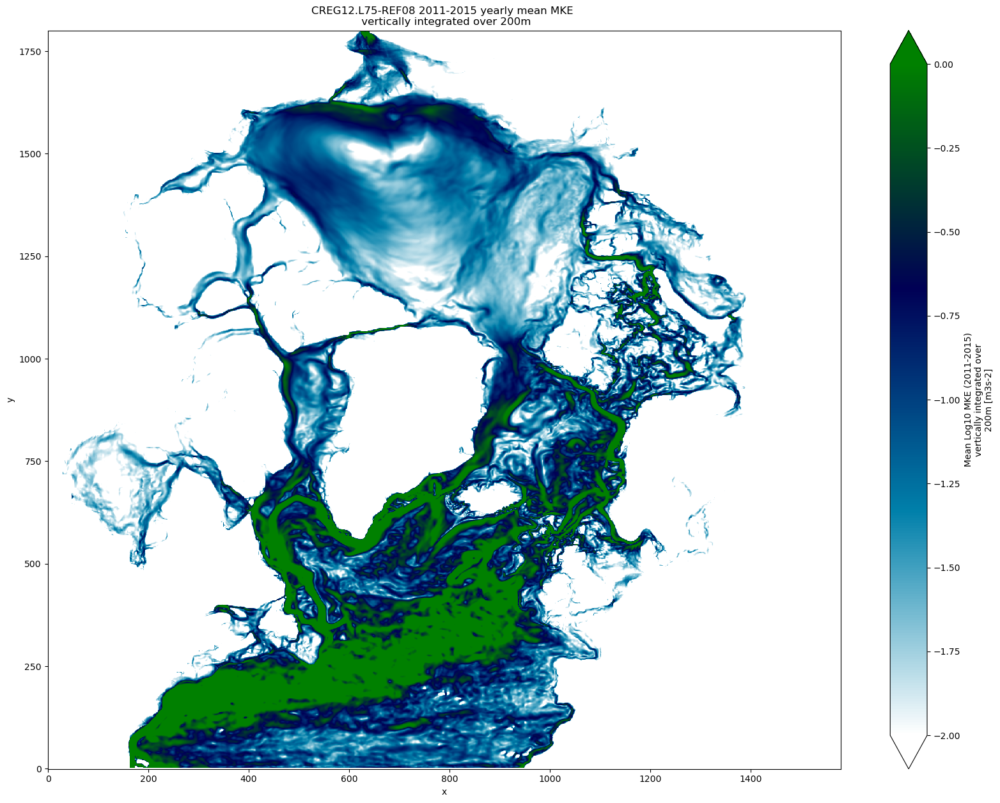

In [49]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvomke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 yearly mean MKE \n vertically integrated over 200m')

CPU times: user 304 ms, sys: 12 ms, total: 316 ms
Wall time: 317 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean EKE \n vertically integrated over 200m')

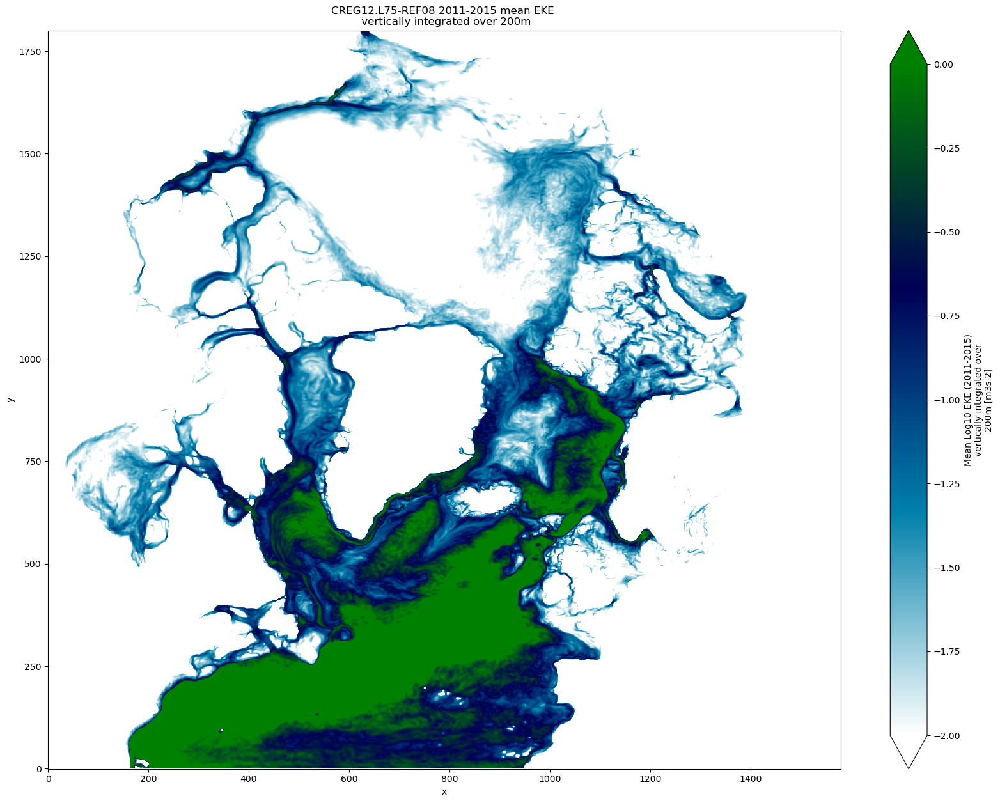

In [50]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvoeke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n vertically integrated over 200m')

# Plot the ratio EKE/TKE

In [20]:
%%time
if False:
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/IMMEDIAT/CONFIGS/SEDNA/DELTA/DIAGS/EKE/1y/'
    ds_EKEDiags=xr.open_dataset(DATAIN+'SEDNA-DELTA_2011-2015.1y_LogZintEKE.nc')

CPU times: user 24 ms, sys: 12 ms, total: 36 ms
Wall time: 179 ms


CPU times: user 312 ms, sys: 32 ms, total: 344 ms
Wall time: 341 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

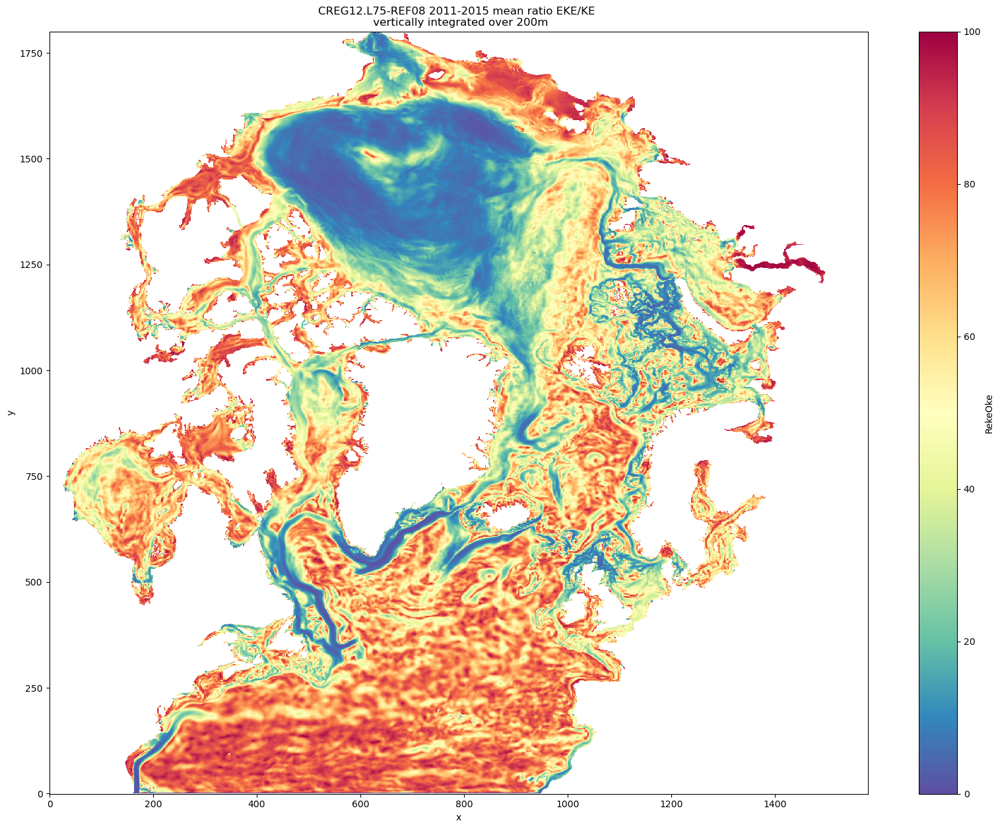

In [51]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RekeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

CPU times: user 296 ms, sys: 36 ms, total: 332 ms
Wall time: 328 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

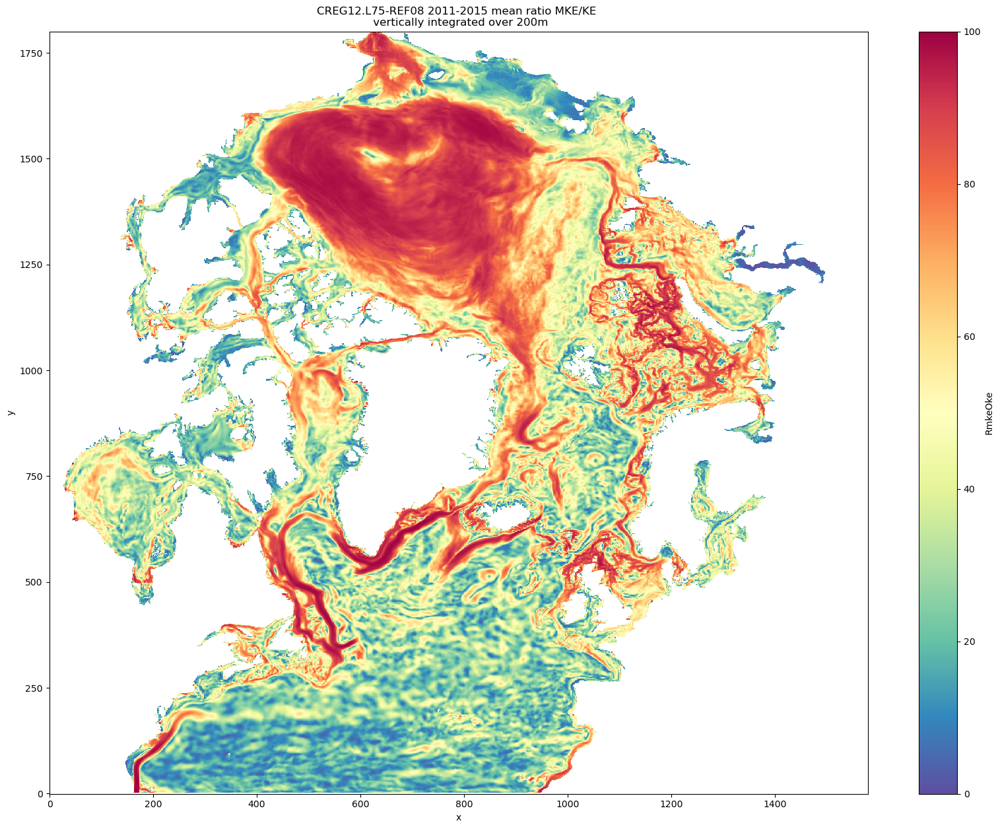

In [52]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RmkeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

In [132]:
client.close()
cluster.close()

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


# PLOT TESTING - PLOT TESTING 

In [24]:
ds_yearout=xr.open_dataset(DATAIN+'SEDNA-DELTA_2011-2015.1y_LogEKE.nc')

In [27]:
ds_yearout.coords['nav_lev']=(ds_mesh['nav_lev'])

In [28]:
ds_yearout

<xarray.Dataset>
Dimensions:   (y: 6540, x: 6560, nav_lev: 57)
Coordinates:
    nav_lon   (y, x) float64 ...
    nav_lat   (y, x) float64 ...
  * nav_lev   (nav_lev) float32 0.4915 1.526 2.63 3.804 ... 181.8 188.0 194.3
Dimensions without coordinates: y, x
Data variables:
    logvoeke  (nav_lev, y, x) float32 ...
    logvotke  (nav_lev, y, x) float32 ...
    logvomke  (nav_lev, y, x) float32 ...

CPU times: user 25.5 s, sys: 2.42 s, total: 27.9 s
Wall time: 27.6 s


<Figure size 640x480 with 0 Axes>

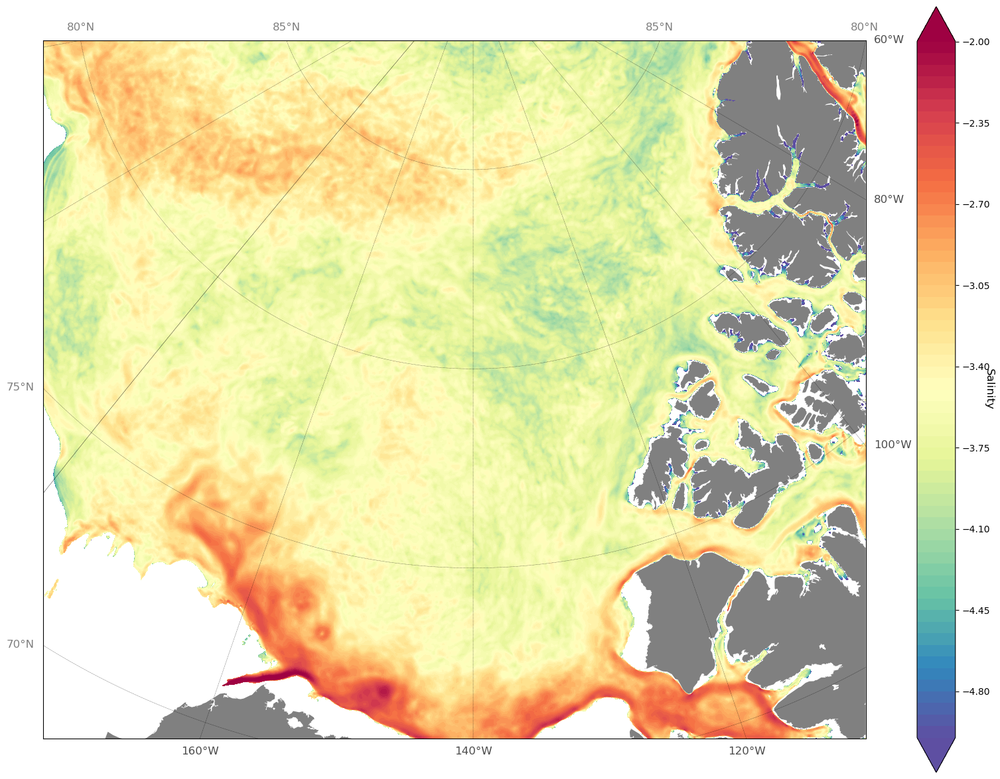

In [30]:
%%time
plt.clf()
vmin=-5. ; vmax=-2. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_yearout['nav_lon']),np.array(ds_yearout['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         #xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         ds_yearout.logvoeke.sel(nav_lev=81,method='nearest'), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Salinity')

#GeoBox(fig)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'.png',dpi=250)

>>> # Plot a zoom of the Beaufort Gyre

<Figure size 432x288 with 0 Axes>

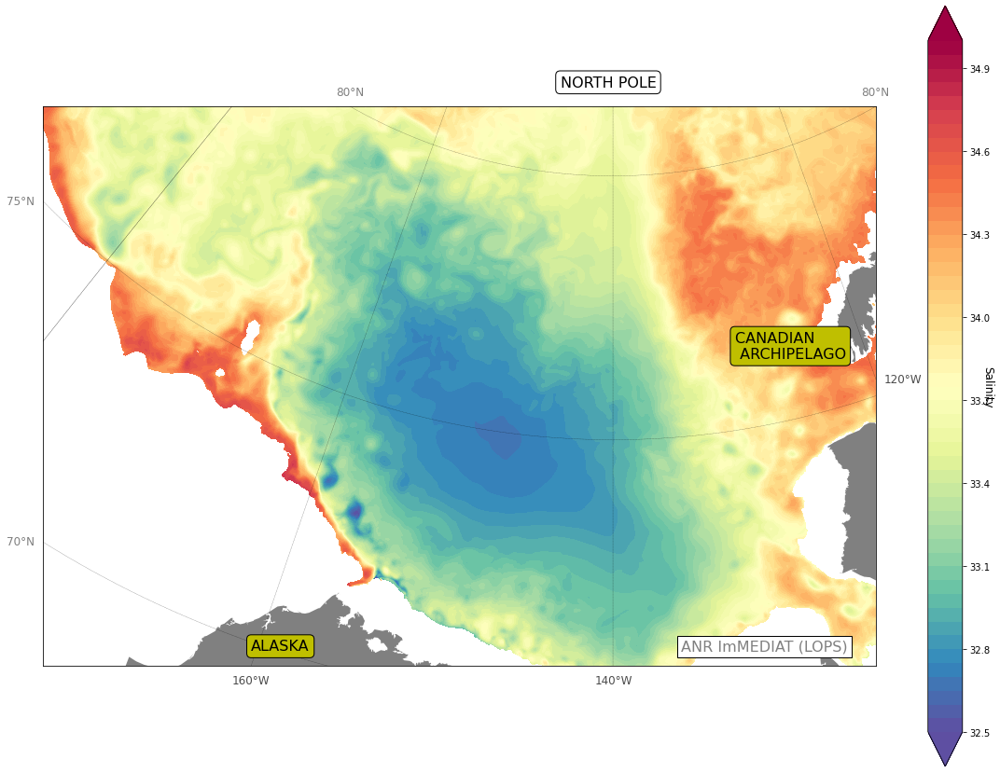

In [40]:
plt.clf()
vmin=32.5 ; vmax=35. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_S['nav_lon']),np.array(ds_alpha_S['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassis_BGZoom',fld='Salinity')

GeoBox(fig,area='zoom')

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'Zoom.png',dpi=250)

In [41]:
ds_alpha_T=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2003m06d23.1d_gridT_Z_SDOM-ARC.nc')

<Figure size 432x288 with 0 Axes>

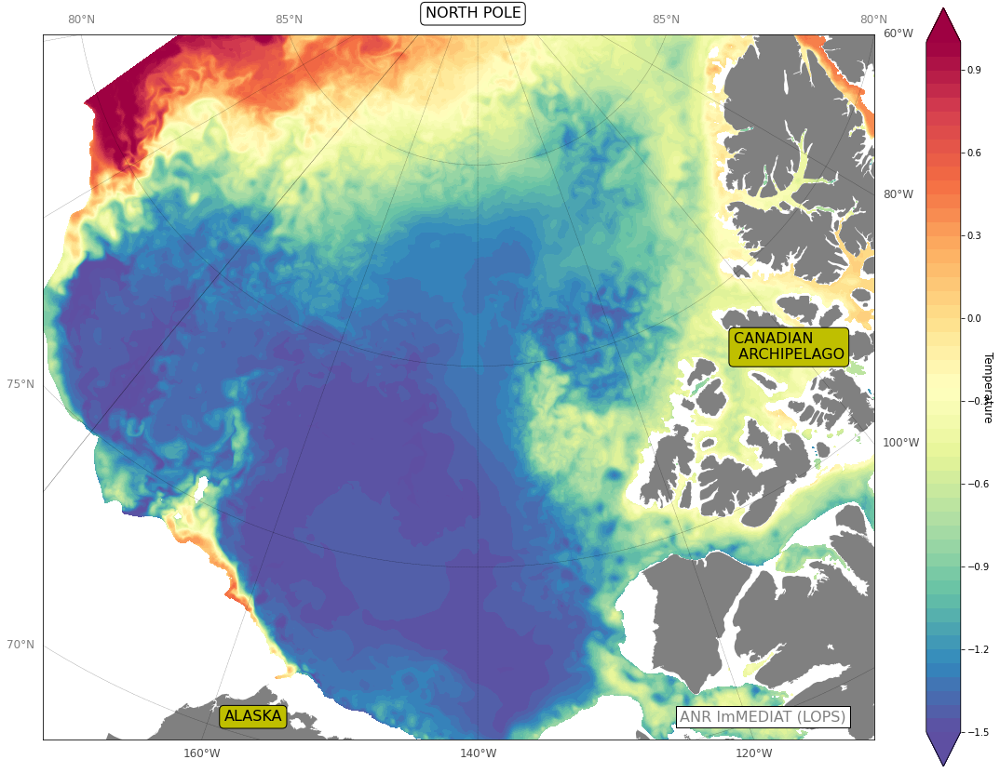

In [42]:
plt.clf()
vmin=-1.5 ; vmax=1. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_T['nav_lon']),np.array(ds_alpha_T['nav_lat']), \
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1.,np.nan,ds_alpha_T['votemper'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Temperature')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_T_z181m_'+ext+'.png',dpi=250)

In [43]:
ds_alpha_xiz181=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2004m06d23.1d_Xif_Z_lev54.nc')

<Figure size 432x288 with 0 Axes>

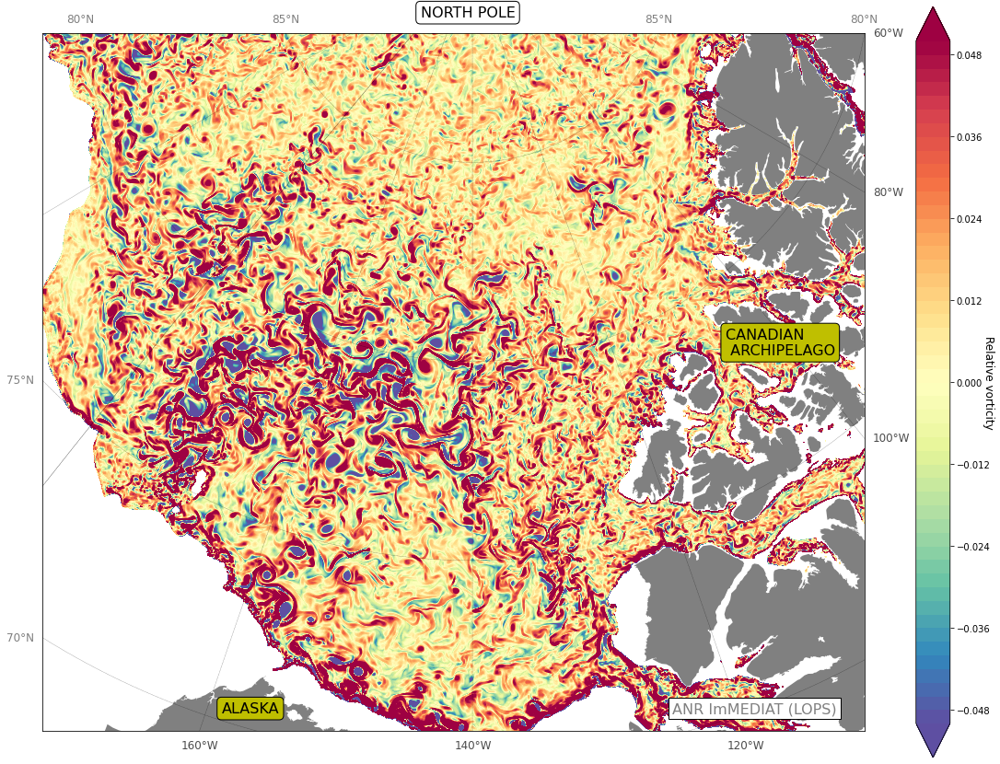

In [44]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r', \
         fld='Relative vorticity')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HR.pdf')

<Figure size 432x288 with 0 Axes>

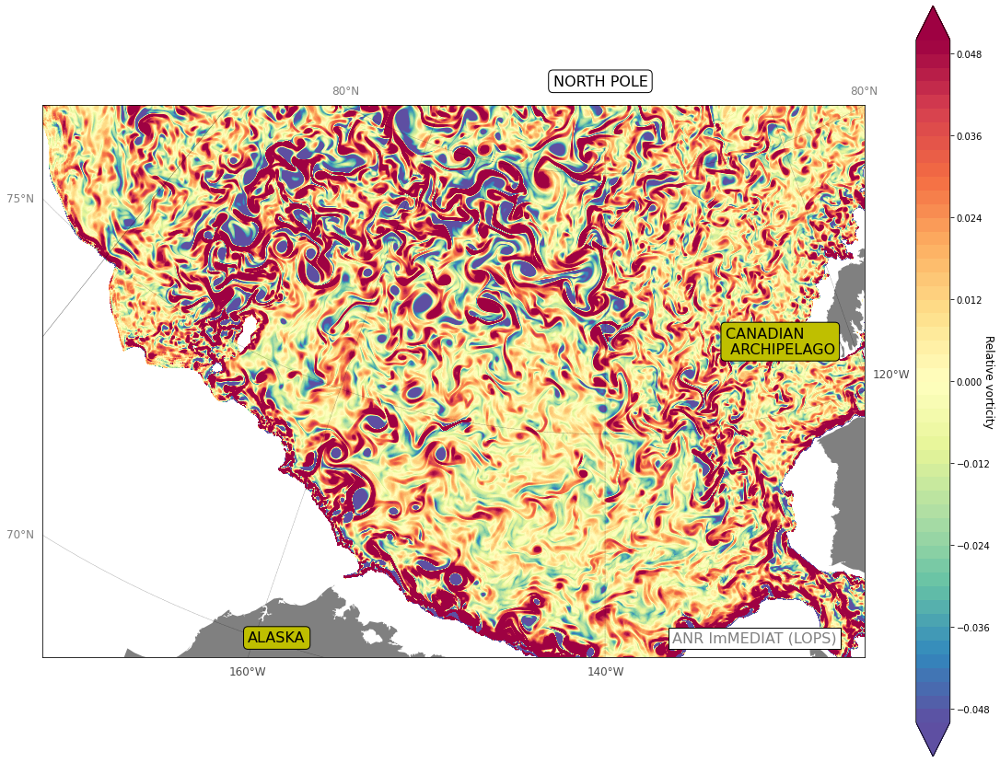

In [21]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r',\
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomSpectral.png',dpi=700)

>> # As the previous plot but with a different color map

In [12]:
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage,AnnotationBbox

In [13]:
lopslogo=mpimg.imread('./FIGURES/LOPS_logo.png')
imagebox=OffsetImage(lopslogo,zoom=0.2)
ab=AnnotationBbox(imagebox,(0.1,0.1),frameon=False)

<Figure size 432x288 with 0 Axes>

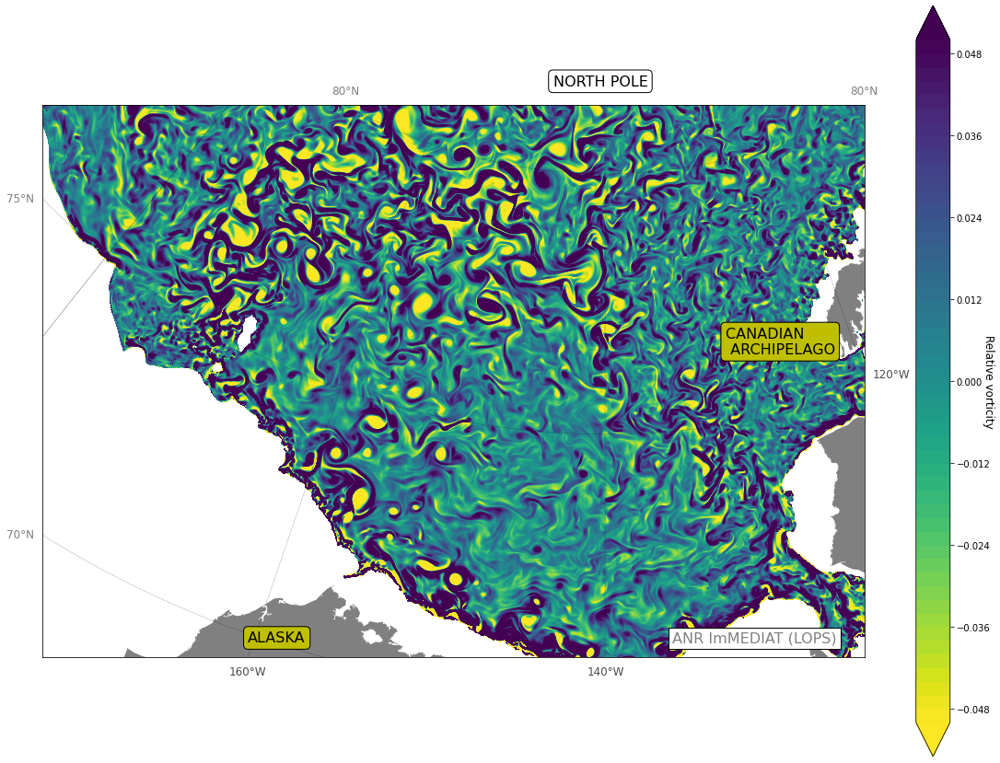

In [22]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
# OK but tiny fig, ax=plt.subplots()
#fig, ax=plt.figure(figsize=(20,15))
#fig, ax=plt.subplots(111)
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='viridis_r', \
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')
#fig, ax=plt.subplots()
#ax.add_artist(ab)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomViridis.png',dpi=700)